In [63]:
import os
import sys
import astropy.io.fits as fits
import numpy as np
import pylab as pl

from   astropy.table import Table, join

In [2]:
from   desiutil.dust import mwdust_transmission
from   prospect      import viewer, utilities
from   desispec.io   import read_spectra

In [5]:
everest_tsnrs                      = Table.read('/global/cfs/cdirs/desi/spectro/redux/everest/exposures-everest.fits', 'EXPOSURES')
everest_tsnrs['TILE_EFFTIME_SPEC'] = everest_tsnrs['EFFTIME_SPEC'].data

del everest_tsnrs['EFFTIME_SPEC']

In [62]:
everest_tsnrs['TILEID', 'TILE_EFFTIME_SPEC']

TILEID,TILE_EFFTIME_SPEC
int32,float32
80254,7.1578417
80255,0.0
80256,0.0
80257,0.0
80258,0.0
80259,0.0
80260,0.0
80261,0.0
80262,0.0


In [8]:
temp = fits.open('/global/common/software/desi/cori/desiconda/20200801-1.4.0-spec/code/desimodel/master/data/tsnr/tsnr-ensemble-bgs.fits')
temp[0].header

SIMPLE  =                    T / conforms to FITS standard                      
BITPIX  =                    8 / array data type                                
NAXIS   =                    0 / number of array dimensions                     
EXTEND  =                    T                                                  
TRACER  = 'bgs     '                                                            
FILTER  = 'decam2014-r'                                                         
ZLO     =                0.126                                                  
ZHI     =                 0.37                                                  
MEDMAG  =                18.87                                                  
LIMMAG  =                19.49                                                  
PSFFLOSS=                0.272                                                  
WGTFLOSS=                1.289                                                  
SMOOTH  =                100

In [9]:
from   desitarget    import targetmask

survey = 'main'
tflag  = 'BGS_TARGET'

In [10]:
fpath = '/global/cfs/cdirs/desi/spectro/redux/everest/zcatalog/ztile-{}-bright-cumulative.fits'.format(survey)
dat   = fits.open(fpath)
dat.info()

Filename: /global/cfs/cdirs/desi/spectro/redux/everest/zcatalog/ztile-main-bright-cumulative.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU       6   ()      
  1  ZCATALOG      1 BinTableHDU    270   1696000R x 120C   [K, D, 10D, D, D, K, K, 6A, 20A, K, D, I, J, K, J, J, D, D, E, E, E, E, K, B, 3A, E, E, J, D, J, I, J, J, 4A, E, E, E, E, E, E, I, K, 2A, E, E, E, E, 8A, E, E, E, E, E, E, E, E, E, E, E, E, E, E, E, 1A, K, K, K, K, K, K, D, D, J, I, E, I, I, E, E, E, E, D, E, D, E, E, E, E, E, E, E, E, E, E, E, E, E, E, E, E, E, E, E, E, E, E, E, E, E, E, E, E, E, E, E, E, E, E, E, E]   
  2  EXP_FIBERMAP    1 BinTableHDU     61   1862000R x 26C   [K, J, D, J, J, D, J, D, I, J, K, J, J, E, E, E, D, D, K, D, D, D, D, D, D, D]   


In [11]:
zbest = Table.read(fpath, 'ZCATALOG')
fmap  = Table.read(fpath, 'EXP_FIBERMAP') 

In [65]:
zbest = join(zbest, everest_tsnrs['TILEID', 'TILE_EFFTIME_SPEC'], keys='TILEID', join_type='left')

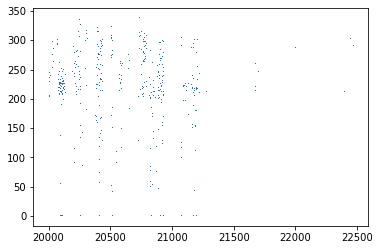

In [67]:
pl.plot(zbest['TILEID'].data, zbest['TILE_EFFTIME_SPEC'].data, marker=',', lw=0.0)

In [69]:
fmap

TARGETID,PRIORITY,SUBPRIORITY,NIGHT,EXPID,MJD,TILEID,EXPTIME,PETAL_LOC,DEVICE_LOC,LOCATION,FIBER,FIBERSTATUS,FIBERASSIGN_X,FIBERASSIGN_Y,LAMBDA_REF,PLATE_RA,PLATE_DEC,NUM_ITER,FIBER_X,FIBER_Y,DELTA_X,DELTA_Y,FIBER_RA,FIBER_DEC,PSF_TO_FIBER_SPECFLUX
int64,int32,float64,int32,int32,float64,int32,float64,int16,int32,int64,int32,int32,float32,float32,float32,float64,float64,int64,float64,float64,float64,float64,float64,float64,float64
39632936659586030,2100,0.8898045796160657,20210514,88385,59349.36647977,20923,399.2758,0,311,311,0,0,80.712036,-287.91705,5400.0,254.02866836295993,32.78814601058069,2,80.708,-287.916,0.008,0.005,254.02870679344207,32.788126404313665,0.7356984740143905
39632936663777376,2100,0.9392995008920402,20210514,88385,59349.36647977,20923,399.2758,0,272,272,1,0,57.371033,-268.13828,5400.0,254.1392079087519,32.86372159877973,2,57.363,-268.139,0.013,0.008,254.1392705376506,32.863690080468345,0.7403908899133331
39632936663779407,2100,0.9538397096587833,20210514,88385,59349.36647977,20923,399.2758,0,252,252,2,0,29.942076,-269.24545,5400.0,254.27084296381005,32.85869525281656,2,29.939,-269.243,0.008,0.006,254.27088146519054,32.85867173820664,0.7553804136761268
39632941747273991,2100,0.36857379932218703,20210514,88385,59349.36647977,20923,399.2758,0,156,156,3,0,4.3957143,-217.3966,5400.0,254.39396195380024,33.0617002810025,2,4.392,-217.383,0.012,-0.004,254.39402014800058,33.061716021218,0.7352785866147586
39632941747275574,2100,0.6416201330389643,20210514,88385,59349.36647977,20923,399.2758,0,198,198,4,0,-15.156455,-254.18259,5400.0,254.48787018988241,32.91679335899171,2,-15.159,-254.172,0.009,-0.001,254.48791356861042,32.91679722724048,0.7388805065065043
39632941743081503,2100,0.8211087472434352,20210514,88385,59349.36647977,20923,399.2758,0,204,204,5,0,44.245037,-236.73672,5400.0,254.20133501903783,32.986063460115055,2,44.245,-236.73,0.006,0.003,254.2013640382045,32.98605150452838,0.774471316719779
39632941743083810,2100,0.9148707509717571,20210514,88385,59349.36647977,20923,399.2758,0,233,233,6,0,12.817468,-260.8199,5400.0,254.3530944469167,32.891162685700344,2,12.815,-260.816,0.008,0.005,254.35313293748635,32.8911430418983,0.7413271050036716
39632941743083238,2100,0.9853411416670134,20210514,88385,59349.36647977,20923,399.2758,0,172,172,7,0,20.680902,-226.05806,5400.0,254.3150593627085,33.027668446679755,2,20.678,-226.047,0.011,-0.001,254.31511258470874,33.02767223285825,0.7535048460904656
39632936659586610,2100,0.9527327827402332,20210514,88385,59349.36647977,20923,399.2758,0,310,310,8,0,73.38342,-292.99805,5400.0,254.0638855980187,32.768310663921774,2,73.376,-293.004,0.011,0.012,254.06393867535988,32.768264060198256,0.7416663211792495


In [13]:
utids, cnts = np.unique(fmap['TARGETID'], return_counts=True)

In [14]:
np.sort(cnts)

array([1, 1, 1, ..., 5, 5, 5])

In [19]:
for i in np.arange(1, cnts.max() + 1 , 1):
    print('{:d} \t {:.3f}'.format(i, len(utids[cnts == i]) / 1.e6))

1 	 1.513
2 	 0.165
3 	 0.006
4 	 0.000
5 	 0.000


In [20]:
singlets = utids[cnts == 1]

In [21]:
len(singlets) / 1.e6

1.513237

In [22]:
zbest

TARGETID,CHI2,COEFF [10],Z,ZERR,ZWARN,NPIXELS,SPECTYPE,SUBTYPE,NCOEFF,DELTACHI2,PETAL_LOC,DEVICE_LOC,LOCATION,FIBER,COADD_FIBERSTATUS,TARGET_RA,TARGET_DEC,PMRA,PMDEC,REF_EPOCH,LAMBDA_REF,FA_TARGET,FA_TYPE,OBJTYPE,FIBERASSIGN_X,FIBERASSIGN_Y,PRIORITY,SUBPRIORITY,OBSCONDITIONS,RELEASE,BRICKID,BRICK_OBJID,MORPHTYPE,FLUX_G,FLUX_R,FLUX_Z,FLUX_IVAR_G,FLUX_IVAR_R,FLUX_IVAR_Z,MASKBITS,REF_ID,REF_CAT,GAIA_PHOT_G_MEAN_MAG,GAIA_PHOT_BP_MEAN_MAG,GAIA_PHOT_RP_MEAN_MAG,PARALLAX,BRICKNAME,EBV,FLUX_W1,FLUX_W2,FLUX_IVAR_W1,FLUX_IVAR_W2,FIBERFLUX_G,FIBERFLUX_R,FIBERFLUX_Z,FIBERTOTFLUX_G,FIBERTOTFLUX_R,FIBERTOTFLUX_Z,SERSIC,SHAPE_R,SHAPE_E1,SHAPE_E2,PHOTSYS,PRIORITY_INIT,NUMOBS_INIT,DESI_TARGET,BGS_TARGET,MWS_TARGET,SCND_TARGET,PLATE_RA,PLATE_DEC,TILEID,COADD_NUMEXP,COADD_EXPTIME,COADD_NUMNIGHT,COADD_NUMTILE,MEAN_DELTA_X,RMS_DELTA_X,MEAN_DELTA_Y,RMS_DELTA_Y,MEAN_FIBER_RA,STD_FIBER_RA,MEAN_FIBER_DEC,STD_FIBER_DEC,MEAN_PSF_TO_FIBER_SPECFLUX,MEAN_FIBER_X,MEAN_FIBER_Y,TSNR2_GPBDARK_B,TSNR2_ELG_B,TSNR2_GPBBRIGHT_B,TSNR2_LYA_B,TSNR2_BGS_B,TSNR2_GPBBACKUP_B,TSNR2_QSO_B,TSNR2_LRG_B,TSNR2_GPBDARK_R,TSNR2_ELG_R,TSNR2_GPBBRIGHT_R,TSNR2_LYA_R,TSNR2_BGS_R,TSNR2_GPBBACKUP_R,TSNR2_QSO_R,TSNR2_LRG_R,TSNR2_GPBDARK_Z,TSNR2_ELG_Z,TSNR2_GPBBRIGHT_Z,TSNR2_LYA_Z,TSNR2_BGS_Z,TSNR2_GPBBACKUP_Z,TSNR2_QSO_Z,TSNR2_LRG_Z,TSNR2_GPBDARK,TSNR2_ELG,TSNR2_GPBBRIGHT,TSNR2_LYA,TSNR2_BGS,TSNR2_GPBBACKUP,TSNR2_QSO,TSNR2_LRG
int64,float64,float64,float64,float64,int64,int64,bytes6,bytes20,int64,float64,int16,int32,int64,int32,int32,float64,float64,float32,float32,float32,float32,int64,uint8,bytes3,float32,float32,int32,float64,int32,int16,int32,int32,bytes4,float32,float32,float32,float32,float32,float32,int16,int64,bytes2,float32,float32,float32,float32,bytes8,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,bytes1,int64,int64,int64,int64,int64,int64,float64,float64,int32,int16,float32,int16,int16,float32,float32,float32,float32,float64,float32,float64,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32
39632936659586030,8600.397160291672,985.5694764302397 .. -0.9250422039916643,0.17450133850871147,7.811871000917407e-06,0,7873,GALAXY,,10,906.8304872512817,0,311,311,0,0,254.02866836295993,32.78814601058069,0.0,0.0,2015.5,5400.0,5764607523034234880,1,TGT,80.712036,-287.91705,2100,0.8898045796160657,575,9011,510108,3054,SER,12.205129,22.924026,35.192436,150.91078,43.26742,12.4266405,0,0,,0.0,0.0,0.0,0.0,2539p327,0.027328046,27.855787,19.979593,3.0489094,0.92114526,3.0741308,5.7739215,8.863991,3.0741308,5.7739215,8.863991,1.9564737,1.7098395,-0.33519897,0.13100317,N,2100,2,5764607523034234880,514,0,131072,254.02866836295993,32.78814601058069,20923,1,399.2758,1,1,0.008,0.008,0.005,0.005,254.02870679344207,0.0,32.788126404313665,0.0,0.73569846,80.708,-287.916,23.50003,0.012787128,4.5584435,8.913334,72.70694,33.13909,0.3045946,0.13213284,2208.5396,4.484039,410.32153,0.008293948,471.01175,2619.2017,1.2770199,6.8021874,3.074143e-06,13.600328,5.948788e-07,0.0,661.5433,4.3021787e-06,2.5912364,6.6755443,2232.0396,18.097155,414.87997,8.921628,1205.262,2652.3408,4.1728506,13.609865
39632936663777376,9021.754892468452,871.9260459704543 .. 40.79161971225653,0.30910522424493664,1.1304665749608628e-05,0,7867,GALAXY,,10,1289.5664004087448,0,272,272,1,0,254.1392079087519,32.86372159877973,0.0,0.0,2015.5,5400.0,5764607523034234880,1,TGT,57.371033,-268.13828,2100,0.9392995008920402,575,9011,510109,96,EXP,3.952269,7.981074,13.998019,326.39526,101.58494,37.38392,0,0,,0.0,0.0,0.0,0.0,2542p327,0.027290601,16.557821,17.759693,4.1207156,1.1333959,1.628375,3.2882836,5.767326,1.628375,3.2882838,5.767327,1.0,1.0460097,0.40169302,0.40430355,N,2100,2,5764607523034234880,265,0,2048,254.1392079087519,32.86372159877

In [23]:
zbest.dtype.names

('TARGETID',
 'CHI2',
 'COEFF',
 'Z',
 'ZERR',
 'ZWARN',
 'NPIXELS',
 'SPECTYPE',
 'SUBTYPE',
 'NCOEFF',
 'DELTACHI2',
 'PETAL_LOC',
 'DEVICE_LOC',
 'LOCATION',
 'FIBER',
 'COADD_FIBERSTATUS',
 'TARGET_RA',
 'TARGET_DEC',
 'PMRA',
 'PMDEC',
 'REF_EPOCH',
 'LAMBDA_REF',
 'FA_TARGET',
 'FA_TYPE',
 'OBJTYPE',
 'FIBERASSIGN_X',
 'FIBERASSIGN_Y',
 'PRIORITY',
 'SUBPRIORITY',
 'OBSCONDITIONS',
 'RELEASE',
 'BRICKID',
 'BRICK_OBJID',
 'MORPHTYPE',
 'FLUX_G',
 'FLUX_R',
 'FLUX_Z',
 'FLUX_IVAR_G',
 'FLUX_IVAR_R',
 'FLUX_IVAR_Z',
 'MASKBITS',
 'REF_ID',
 'REF_CAT',
 'GAIA_PHOT_G_MEAN_MAG',
 'GAIA_PHOT_BP_MEAN_MAG',
 'GAIA_PHOT_RP_MEAN_MAG',
 'PARALLAX',
 'BRICKNAME',
 'EBV',
 'FLUX_W1',
 'FLUX_W2',
 'FLUX_IVAR_W1',
 'FLUX_IVAR_W2',
 'FIBERFLUX_G',
 'FIBERFLUX_R',
 'FIBERFLUX_Z',
 'FIBERTOTFLUX_G',
 'FIBERTOTFLUX_R',
 'FIBERTOTFLUX_Z',
 'SERSIC',
 'SHAPE_R',
 'SHAPE_E1',
 'SHAPE_E2',
 'PHOTSYS',
 'PRIORITY_INIT',
 'NUMOBS_INIT',
 'DESI_TARGET',
 'BGS_TARGET',
 'MWS_TARGET',
 'SCND_TARGET',
 'PLAT

In [24]:
100. * np.mean(zbest['COADD_FIBERSTATUS'].data > 0.0)

16.817216981132074

In [25]:
np.unique(zbest['COADD_NUMEXP'].data, return_counts=True)

(array([0, 1, 2, 3], dtype=int16), array([ 120060, 1427046,  144783,    4111]))

In [26]:
# zbest['PRIORITY'].data

In [32]:
zbest['ISBRIGHT'] = (targetmask.bgs_mask['BGS_BRIGHT'] & zbest[tflag]) != 0

In [33]:
zbest['ISFAINT']  = (targetmask.bgs_mask['BGS_FAINT']  & zbest[tflag]) != 0

In [30]:
zbest['ISSINGLET'] = np.isin(zbest['TARGETID'].data, singlets)
# zbest['ISSINGLET'] = True

In [35]:
np.unique(zbest['PRIORITY'].data[zbest['ISSINGLET'].data & zbest['ISBRIGHT'].data])

array([2100, 2998], dtype=int32)

In [36]:
np.unique(zbest['PRIORITY'].data[zbest['ISSINGLET'].data & zbest['ISFAINT'].data])

array([2000, 2100], dtype=int32)

In [37]:
# zbest['ASSIGNED'] = (zbest['COADD_FIBERSTATUS'].data == 0) & (zbest['PRIORITY'].data == 102100)
zbest['ASSIGNED']  = (zbest['COADD_FIBERSTATUS'].data == 0) # & (zbest['COADD_NUMEXP'] == 1)

In [38]:
zbest['GOODZ']     = zbest['ASSIGNED'].data & (zbest['ZWARN'].data == 0) & (zbest['DELTACHI2'].data >= 40.)

In [39]:
100. * np.count_nonzero(zbest['GOODZ']) / np.count_nonzero(zbest['ASSIGNED'])

95.25624122825671

In [40]:
np.count_nonzero(zbest['ASSIGNED'])

1410780

In [41]:
100. * np.count_nonzero(zbest['GOODZ'] & zbest['ISBRIGHT']) / np.count_nonzero(zbest['ASSIGNED'] & zbest['ISBRIGHT'])

98.01326254526923

In [42]:
100. * np.count_nonzero(zbest['GOODZ'] & zbest['ISBRIGHT'] & zbest['ISSINGLET']) / np.count_nonzero(zbest['ASSIGNED'] & zbest['ISBRIGHT'] & zbest['ISSINGLET'])

98.07921002335952

In [43]:
100. * np.count_nonzero(zbest['GOODZ'] & zbest['ISFAINT']) / np.count_nonzero(zbest['ASSIGNED'] & zbest['ISFAINT'])

97.34455222759306

In [46]:
100. * np.count_nonzero(zbest['GOODZ'] & zbest['ISFAINT'] & zbest['ISSINGLET']) / np.count_nonzero(zbest['ASSIGNED'] & zbest['ISFAINT'] & zbest['ISSINGLET'])

97.51864159507214

In [50]:
zbest['EFFTIME_SPEC']   = 0.14 * zbest['TSNR2_BGS']

Text(0.5, 0, 'BGS EFFTIME SPEC.')

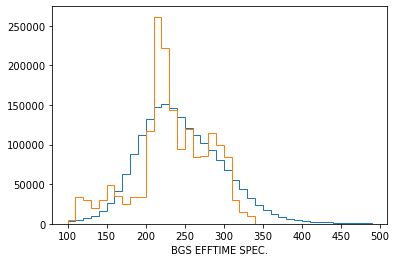

In [71]:
_ = pl.hist(zbest['EFFTIME_SPEC'].data,        histtype='step', bins=np.arange(100., 500., 10.))
_ = pl.hist(zbest['TILE_EFFTIME_SPEC'].data,   histtype='step', bins=np.arange(100., 500., 10.))

pl.xlabel('BGS EFFTIME SPEC.')

In [58]:
zbest['SURVEY_SPEED'] = zbest['EFFTIME_SPEC'].data / zbest['COADD_EXPTIME'].data / 10. ** (2. * 2.165 * zbest['EBV'].data / 2.5)

<ipython-input-58-5886aa29f6f8>:1: RuntimeWarning: divide by zero encountered in true_divide
  zbest['SURVEY_SPEED'] = zbest['EFFTIME_SPEC'].data / zbest['COADD_EXPTIME'].data / 10. ** (2. * 2.165 * zbest['EBV'].data / 2.5)


In [72]:
zbest['TILE_SURVEY_SPEED'] = zbest['TILE_EFFTIME_SPEC'].data / zbest['COADD_EXPTIME'].data / 10. ** (2. * 2.165 * zbest['EBV'].data / 2.5)

<ipython-input-72-8585cbe8303e>:1: RuntimeWarning: divide by zero encountered in true_divide
  zbest['TILE_SURVEY_SPEED'] = zbest['TILE_EFFTIME_SPEC'].data / zbest['COADD_EXPTIME'].data / 10. ** (2. * 2.165 * zbest['EBV'].data / 2.5)
<ipython-input-72-8585cbe8303e>:1: RuntimeWarning: invalid value encountered in true_divide
  zbest['TILE_SURVEY_SPEED'] = zbest['TILE_EFFTIME_SPEC'].data / zbest['COADD_EXPTIME'].data / 10. ** (2. * 2.165 * zbest['EBV'].data / 2.5)


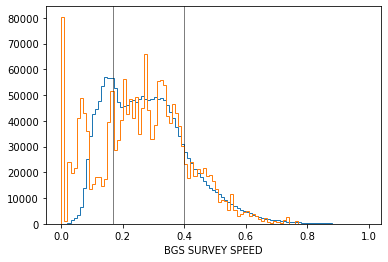

In [73]:
_ = pl.hist(zbest['SURVEY_SPEED'].data,      histtype='step', bins=np.arange(0., 1.0, 0.01))
_ = pl.hist(zbest['TILE_SURVEY_SPEED'].data, histtype='step', bins=np.arange(0., 1.0, 0.01))

pl.xlabel('BGS SURVEY SPEED')

pl.axvline(1. / 6.,  c='k', lw=0.5)
pl.axvline(1. / 2.5, c='k', lw=0.5)

In [87]:
def plot_zfrac_speed(zbest, tt='ISBRIGHT', ss='TILE_SURVEY_SPEED'):
    zbest              = Table(zbest, copy=True)
    
    zbest['NUMERATOR'] =    zbest['GOODZ'].data * zbest[tt].data * zbest['ISSINGLET'].data
    zbest['DENOM']     = zbest['ASSIGNED'].data * zbest[tt].data * zbest['ISSINGLET'].data

    zbest['SPEED_IDX'] = np.digitize(zbest[ss], bins=np.arange(0., 1.0, 0.025))
    
    zbest_grouped      = zbest.group_by(['SPEED_IDX'])

    # np.count_nonzero(zbest['NUMERATOR']) / np.count_nonzero(zbest['DENOM'])
    # np.count_nonzero(zbest['DENOM']), np.sum(zbest['DENOM'])
    
    zbest_binned       = zbest_grouped['NUMERATOR', 'DENOM'].groups.aggregate(np.sum)
    zbest_meanbinned   = zbest_grouped[ss].groups.aggregate(np.mean)
    
    zbest_binned[ss] = zbest_meanbinned.data

    isin               = zbest_binned['DENOM'] > 0
    
    zbest_binned['ZSUCCESSFRAC'] = 0.0    
    zbest_binned['ZSUCCESSFRAC'][isin] = zbest_binned['NUMERATOR'][isin] / zbest_binned['DENOM'][isin]
    
    pl.plot(zbest_binned[ss].data[isin], zbest_binned['ZSUCCESSFRAC'].data[isin])

    pl.axhline(0.95, c='k',    lw=0.5)
    pl.axhline(1.00, c='gold', lw=0.75)

    pl.axvline(1. / 6., c='k', lw=0.5)
    pl.axvline(0.70, c='k', lw=0.5)

    pl.ylim(0.7, 1.05)
    
    pl.xlabel(ss)
    pl.title(tt)

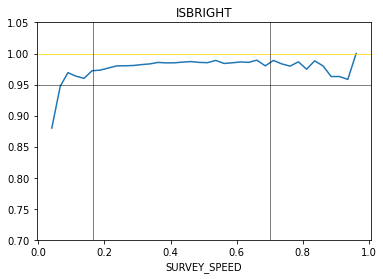

In [88]:
plot_zfrac_speed(zbest, tt='ISBRIGHT', ss='SURVEY_SPEED')

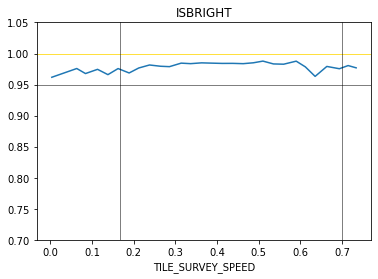

In [90]:
plot_zfrac_speed(zbest, tt='ISBRIGHT', ss='TILE_SURVEY_SPEED')

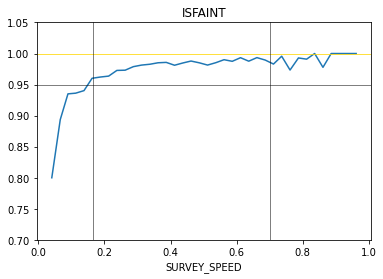

In [92]:
plot_zfrac_speed(zbest, tt='ISFAINT', ss='SURVEY_SPEED')

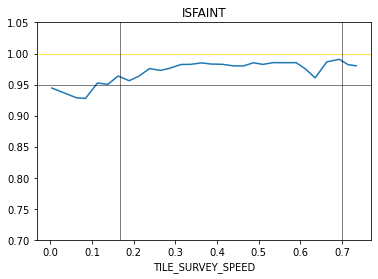

In [91]:
plot_zfrac_speed(zbest, tt='ISFAINT', ss='TILE_SURVEY_SPEED')

(0.0, 1.0)

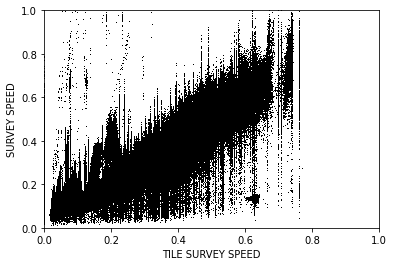

In [96]:
pl.plot(zbest['TILE_SURVEY_SPEED'].data, zbest['SURVEY_SPEED'], marker=',', lw=0.0, c='k')

pl.xlabel('TILE SURVEY SPEED')
pl.ylabel('SURVEY SPEED')

pl.xlim(0.0, 1.0)
pl.ylim(0.0, 1.0)

In [67]:
result = []

for tid in np.unique(zbest['TILEID'].data):
    in_tile = zbest['TILEID'].data == tid
    denom   = np.count_nonzero(in_tile & zbest['ASSIGNED'] & zbest['ISBRIGHT'] & zbest['ISSINGLET'])
    
    if denom > 0:
        zfrac   = 100. * np.count_nonzero(in_tile & zbest['GOODZ'] & zbest['ISBRIGHT'] & zbest['ISSINGLET']) / denom
    
        result.append([tid, zfrac])
    
result = Table(np.array(result), names=['TILEID', 'ZFRAC'])
result['TILEID'] = result['TILEID'].astype(np.int)
result.sort('ZFRAC')

result = result[:20]
result

TILEID,ZFRAC
int64,float64
20886,55.839416058394164
20824,69.46308724832215
20823,72.41379310344827
20095,77.27272727272727
20548,80.0
20928,83.76824413976117
20514,85.71428571428571
21193,86.7831541218638
20299,90.4


0
1
2


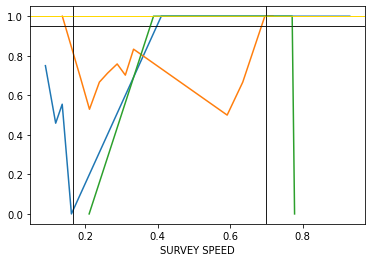

In [128]:
for ii, tid in enumerate(result['TILEID']):
    in_tile = zbest['TILEID'].data == tid
    denom   = np.count_nonzero(in_tile & zbest['ASSIGNED'] & zbest['ISBRIGHT'] & zbest['ISSINGLET'])
    
    if denom > 0:
        zfrac = 100. * np.count_nonzero(in_tile & zbest['GOODZ'] & zbest['ISBRIGHT'] & zbest['ISSINGLET']) / denom
    
        tile_zbest = Table(zbest[in_tile], copy=True)
    
        plot_zfrac_speed(tile_zbest)

    print(ii)
        
    if ii > 1:
        break

In [69]:
low_zfrac = zbest[np.isin(zbest['TILEID'], result['TILEID'])]

In [70]:
low_zfrac = low_zfrac[low_zfrac['ASSIGNED'].data]

20886 55.839416058394164 (array([0], dtype=int32), array([121]))


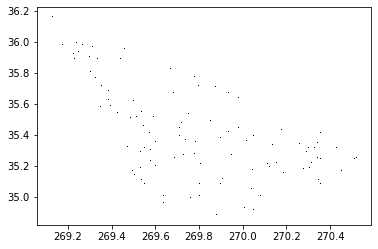

20824 69.46308724832215 (array([0], dtype=int32), array([91]))


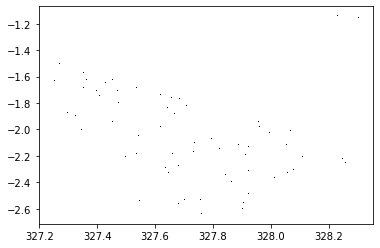

20823 72.41379310344827 (array([0], dtype=int32), array([8]))


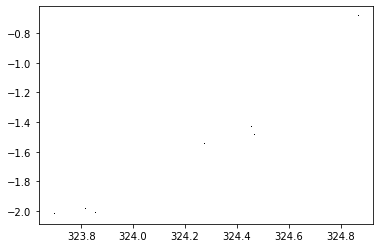

20095 77.27272727272727 (array([0], dtype=int32), array([5]))


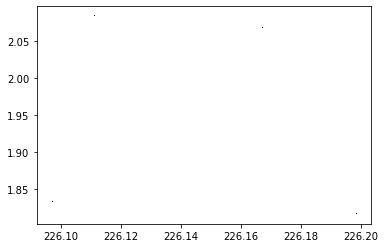

20548 80.0 (array([0], dtype=int32), array([1]))


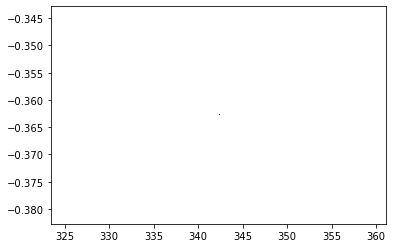

20928 83.76824413976117 (array([0], dtype=int32), array([367]))


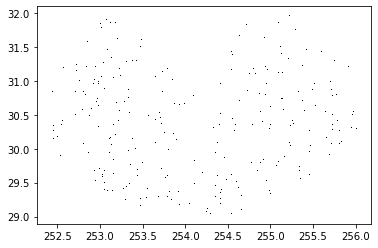

20514 85.71428571428571 (array([0], dtype=int32), array([1]))


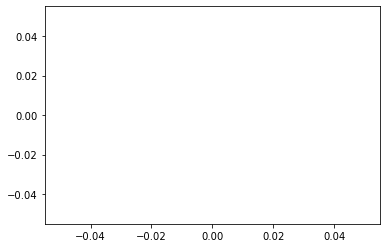

21193 86.7831541218638 (array([0], dtype=int32), array([295]))


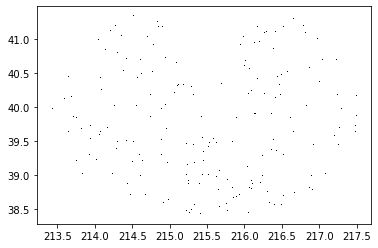

20299 90.4 (array([0], dtype=int32), array([216]))


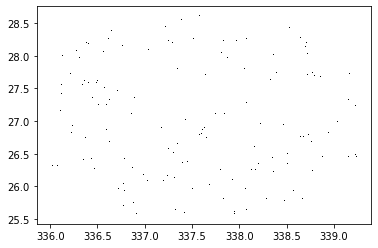

20835 92.3076923076923 (array([0], dtype=int32), array([1]))


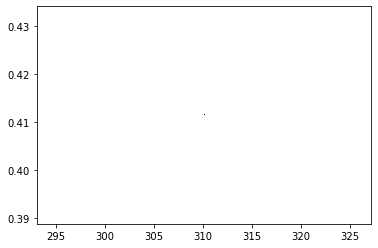

21071 93.33333333333333 (array([0], dtype=int32), array([7]))


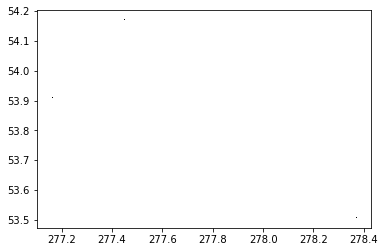

20732 93.77537212449256 (array([0], dtype=int32), array([138]))


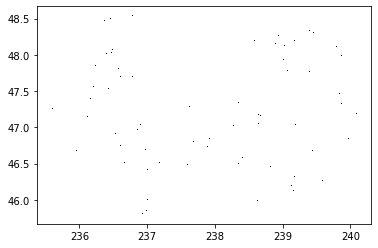

20245 94.87179487179488 (array([0], dtype=int32), array([122]))


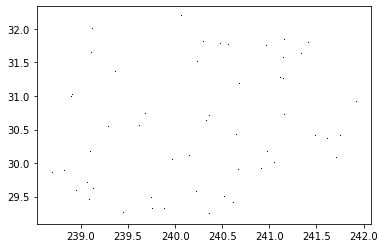

20505 95.21721801514548 (array([0], dtype=int32), array([120]))


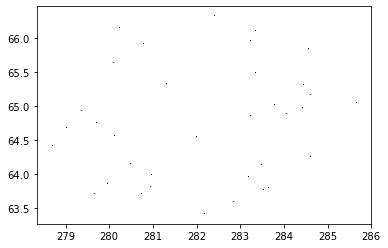

20825 95.5028618152085 (array([0], dtype=int32), array([110]))


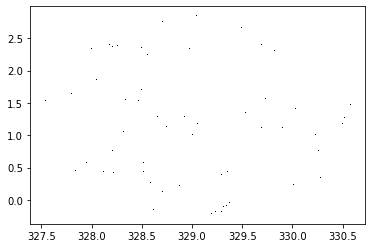

21075 95.70798235058163 (array([0], dtype=int32), array([107]))


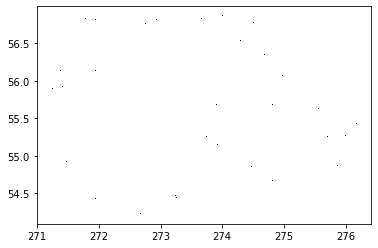

20302 95.79030976965846 (array([0], dtype=int32), array([106]))


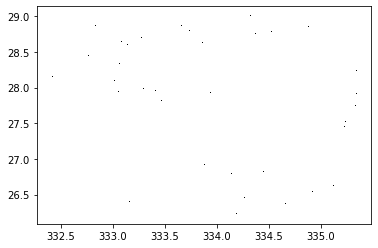

20310 95.89442815249267 (array([0], dtype=int32), array([84]))


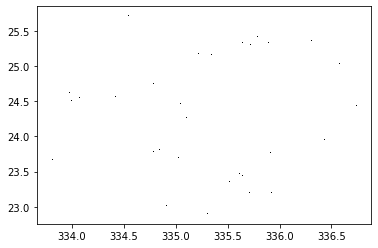

20040 95.91160220994475 (array([0], dtype=int32), array([111]))


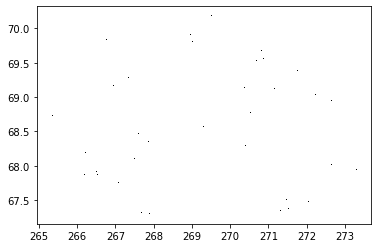

20903 95.91836734693878 (array([0], dtype=int32), array([102]))


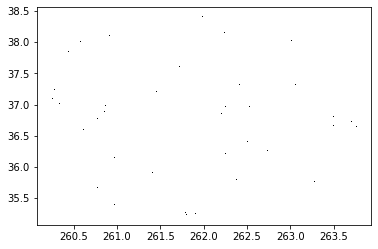

In [123]:
for tid, zfrac in zip(result['TILEID'].data, result['ZFRAC'].data):
    sample = zbest[(zbest['TILEID'].data == tid) & zbest['ASSIGNED'] & zbest['ISBRIGHT'] & (zbest['ISSINGLET'].data) & ~zbest['GOODZ']]
    
    print(tid, zfrac, np.unique(sample['COADD_FIBERSTATUS'].data, return_counts=True))
    
    petals, cnts = np.unique(sample['PETAL_LOC'].data, return_counts=True)
    
    # print(tid)
    # print(petals)
    # print(cnts)
    # print
    
    sample['FIBERRMAG_DRED'] = 22.5 - 2.5 * np.log10(sample['FIBERFLUX_R'].data  / mwdust_transmission(sample['EBV'], 'r', sample['PHOTSYS'].astype(str), match_legacy_surveys=False))
    
    sample        = sample[sample['FIBERRMAG_DRED'] < 21.0] 
    
    pl.plot(sample['TARGET_RA'], sample['TARGET_DEC'], marker=',', lw=0.0, c='k')
    # pl.title(tid)
    # pl.show()
    
    sample['RA']   = sample['TARGET_RA'].data
    sample['Dec']  = sample['TARGET_DEC'].data
    sample['name'] = sample['TARGETID'].data.astype(str)
    
    # sample['RA', 'Dec'].write('/global/cscratch1/sd/mjwilson/desi/BGS/fails/main_{:d}.fits'.format(tid), format='fits', overwrite=True)
        
    pl.show()

In [110]:
datadir = os.environ['DESI_SPECTRO_REDUX'] + '/everest/tiles/cumulative/'
tiles   = result['TILEID'].data[1:2].astype(np.str)
tiles

array(['20824'], dtype='<U21')

In [111]:
subset_db = utilities.create_subsetdb(datadir, dirtree_type='cumulative', tiles=tiles)
subset_db

[{'dataset': '20824',
  'subset': '20210617',
  'petals': ['0', '1', '2', '3', '4', '5', '6', '7', '8', '9']}]

In [112]:
target_db = utilities.create_targetdb(datadir, subset_db, dirtree_type='cumulative')
# target_db

In [113]:
targets = zbest[(np.isin(zbest['TILEID'].data, tiles.astype(np.int))) & zbest['ASSIGNED'] & zbest['ISBRIGHT'] & (zbest['ISSINGLET'].data) & ~zbest['GOODZ']]
targets = targets['TARGETID']
targets.data

array([39627760032816450, 39627760037004915, 39627729829628232,
       39627735869428605, 39627735869427355, 39627729829630778,
       39627729829630597, 39627735869428910, 39627729829629038,
       39627735869426610, 39636537993857945, 39636537993859520,
       39627753980432251, 39627753980432632, 39627747940638780,
       39627747940638003, 39627747940637102, 39627747940634322,
       39627747940635983, 39627741905027260, 39627735865233406,
       39627735865233729, 39627735865235348, 39627735865234818,
       39627735869426702, 39627735865234198, 39627741905034657,
       39627735865236190, 39627741909222729, 39627735869425975,
       39636537993860026, 39627747944830819, 39627747944830385,
       39636537993861769, 39627741905028526, 39627747944831972,
       39627747940638949, 39636537993861451, 39627747944827877,
       39627747944829453, 39627747944826501, 39627735877812330,
       39627735873622371, 39627735873624458, 39627735873620842,
       39627741913420952, 39627735873621

In [114]:
# targets = np.array([39632996168370587]).astype(np.int64)

In [115]:
spectra, zcat, rrcat = utilities.load_spectra_zcat_from_targets(targets, datadir, target_db, dirtree_type='cumulative', with_redrock_details=True)

INFO:spectra.py:282:read_spectra: iotime 0.628 sec to read coadd-7-20824-thru20210617.fits at 2021-09-07T05:28:05.151305
INFO:spectra.py:282:read_spectra: iotime 0.626 sec to read coadd-9-20824-thru20210617.fits at 2021-09-07T05:28:16.305282


In [116]:
spectra.bands

['b', 'r', 'z']

In [117]:
viewer.plotspectra(spectra, zcatalog=zcat, redrock_cat=rrcat, notebook=True,
                   title='BGS {}'.format(survey), top_metadata=['TARGETID', 'TILEID', 'mag_G'])

/global/common/software/desi/cori/desiconda/20200801-1.4.0-spec/conda/lib/python3.8/site-packages/astropy/table/column.py:1020: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  result = getattr(super(), op)(other)


Loading BokehJS ...

In [68]:
low_zfracs = {} 

for ut in badids:
    low_zfracs[ut] = low_zfrac[low_zfrac['TILEID'].data == ut]

In [69]:
low_zfracs.keys()

dict_keys([156, 595, 129, 127, 128, 594, 126, 124, 399, 398])

In [70]:
uts = list(low_zfracs.keys())

for ut in uts:
    sample = low_zfracs[ut]
    
    fails  = (~sample['GOODZ'] & sample['ISBRIGHT'] & sample['ISSINGLET'])
    passes = ( sample['GOODZ'] & sample['ISBRIGHT'] & sample['ISSINGLET'])
    
    denom  = np.count_nonzero(passes | fails)
    
    if denom > 0:
        zfrac  =  np.count_nonzero(passes) / denom

                                                  
        print('{:d} \t {:d} \t {:d} \t {:.4f}'.format(len(sample),\
                                                      np.count_nonzero(fails),\
                                                      np.count_nonzero(passes),\
                                                      zfrac))

4142 	 6 	 91 	 0.9381
4138 	 2 	 48 	 0.9600
4109 	 5 	 92 	 0.9485
4107 	 7 	 152 	 0.9560
4067 	 7 	 127 	 0.9478
4039 	 4 	 46 	 0.9200
3959 	 12 	 213 	 0.9467
3957 	 17 	 419 	 0.9610
3692 	 3 	 52 	 0.9455
3572 	 3 	 65 	 0.9559


# Done.